# Major Project - Deployment and monitoring

## 0. Used libraries, paths and functions:

In [ ]:
# Libraries:
import json
import math
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
from PIL import Image
from tabulate import tabulate
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
from torchvision import datasets, models, transforms
from torchvision.models import efficientnet_b4, EfficientNet_B4_Weights
from torchvision.models import mobilenet_v2, MobileNet_V2_Weights
from torchvision.transforms import v2

In [ ]:
# Checking if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [ ]:
# Setting path to the dataset (containing all images from all team members before phase 4)
dataset_path = 'Dataset_extended'

# Setting path to the new test dataset (containing new images with different conditions for phase 4)
dataset_path_test = 'Dataset_different_conditions'

#Setting path to a JSON file, which contains information about model evaluation metrics
json_file_path = 'accuracy.json'

# Setting paths to the screenshots for the website user interface
ui_model_1_path = 'Website_Model_1'
ui_model_2_path = 'Website_Model_2'

In [ ]:
# Defining a function to save evaluation metrics to a JSON file
def save_model_metrics(json_file_path, phase, accuracy, eval_loss):
    try:
        with open(json_file_path, 'r') as file:
            data = json.load(file)
    except FileNotFoundError:
        data = {}

    data[phase] = {
        'accuracy': f"{accuracy:.2f}%",
        'evaluation loss': f"{eval_loss:.4f}"
    }
    with open(json_file_path, 'w') as f:
        json.dump(data, f, indent=4)
    print(f"Model metrics for {phase} saved to '{json_file_path}'")

# Defining a function to visualize information about accuracy and evaluation loss from a JSON file
def json_to_table(json_file_path):
    with open(json_file_path, 'r') as file:
        data = json.load(file)
    df = pd.DataFrame.from_dict(data, orient='index')
    return df

# Defining a function to visualize information about errors of missclassified images of a JSON file
def json_to_table_v2(json_file_path, models_to_print):
    with open(json_file_path, 'r') as file:
        data = json.load(file)
    selected_data = {model: metrics for model, metrics in data.items() if model in models_to_print}
    df = pd.DataFrame.from_dict(selected_data, orient='index').transpose()
    return df

# Defining a function to plot misclassified images
def plot_misclassified(misclassified, title, class_names=None):
    num_images = len(misclassified)
    num_columns = 6
    num_rows = math.ceil(num_images / num_columns)

    plt.figure(figsize=(15, 2.5 * num_rows))
    plt.suptitle(title, fontsize=16, y=0.95)

    for i, (image, label, prediction) in enumerate(misclassified):
        plt.subplot(num_rows, num_columns, i + 1)
        image = image.permute(1, 2, 0)
        image = (image - image.min()) / (image.max() - image.min())
        plt.imshow(image.numpy())
        true_label = class_names[label.item()] if class_names else label.item()
        predicted_label = class_names[prediction.item()] if class_names else prediction.item()
        plt.title(f'True: {true_label}\nPred: {predicted_label}', fontsize=10)
        plt.axis('off')

    plt.tight_layout(pad=2.0, rect=[0, 0, 1, 0.96])
    plt.show()

#Defining a function to count error types of missclassified images
def count_errors(misclassified_list):
    error_counts = {}
    for _, true_label, pred_label in misclassified_list:
        # Converting tensor to integer if needed
        true_label_int = true_label.item() if hasattr(true_label, 'item') else true_label
        pred_label_int = pred_label.item() if hasattr(pred_label, 'item') else pred_label

        true_name = class_names[true_label_int]
        pred_name = class_names[pred_label_int]
        error_key = f'True: {true_name}, Pred: {pred_name}'
        error_counts[error_key] = error_counts.get(error_key, 0) + 1
    return error_counts

## 1. Selection of the best phase 3 model as a baseline

### 1.1 Available models and their accuracy

Based on our work from phase 3, we used our two individual models and trained it on the extended dataset, which contains all images from all team members before phase 4). Here is an overview of the models and its corresponding accuracies:
- MobileNetV2: 98.7%
- EfficientNetB4: 98.5%
- ResNet50: 95.0%
- InceptionV3: 94.0%
- InceptionV3: 88.9%
- ResNet-152: 40.0%

As a result, the MobileNetV2 has the best accuracy on the new combined (extended) dataset. This will be the model for the rest of this assignment.

### 1.2 Introduction to the dataset

#### Class names and number of classes:

In [ ]:
class_names = {
    0: 'Basil',
    1: 'Catmint',
    2: 'Catnip',
    3: 'Chives',
    4: 'Coral',
    5: 'Cress',
    6: 'Curry',
    7: 'Fennel',
    8: 'Lemon Grass',
    9: 'Mint',
    10: 'Mustard Greens',
    11: 'Olive Herbs',
    12: 'Oregano',
    13: 'Parsley',
    14: 'Rosemary',
    15: 'Sage',
    16: 'Sorrel',
    17: 'Tarragon',
    18: 'Thyme',
    19: 'Verbena'
}
print("Class names:", ", ".join(class_names.values()))

class_count=len(class_names)
print("\nNumber of classes:",class_count)

Class names: Basil, Catmint, Catnip, Chives, Coral, Cress, Curry, Fennel, Lemon Grass, Mint, Mustard Greens, Olive Herbs, Oregano, Parsley, Rosemary, Sage, Sorrel, Tarragon, Thyme, Verbena

Number of classes: 20


#### Visual insight with one image per class:

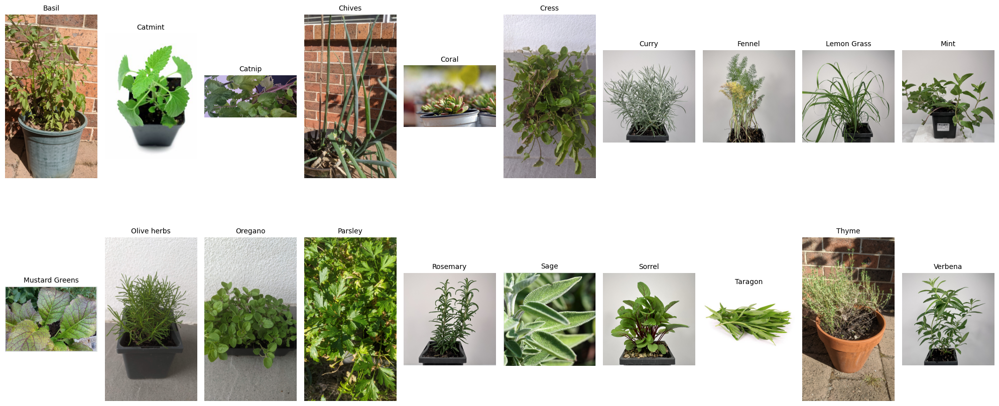

In [ ]:
# Defining the index of the image to select from each category
selected_index = 0

# Counting the number of directories (herb categories)
num_categories = len([name for name in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, name))])

# Setting the number of rows and columns for the plot
nrows = 2
ncols = num_categories // nrows + (num_categories % nrows > 0)

# Defining the plot
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 10))
if nrows > 1:
    axs = axs.flatten()

# Looping through each category
for i, category in enumerate(sorted(os.listdir(dataset_path))):
    category_path = os.path.join(dataset_path, category)
    images = sorted([img for img in os.listdir(category_path) if img.lower().endswith('.jpg')])
    if not images:
        print(f"No images found in category {category}.")
        axs[i].imshow(np.zeros((100, 100, 3), dtype=np.uint8))
        axs[i].set_title(f"{category} (Empty)", fontsize=10)
        axs[i].axis('off')
        continue
    try:
        image = images[selected_index]
        img_path = os.path.join(category_path, image)
        img = Image.open(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')
        axs[i].set_title(category, fontsize=10)
    except Exception as e:
        print(f"Error loading image from category {category}: {e}")
        axs[i].imshow(np.zeros((100, 100, 3), dtype=np.uint8))
        axs[i].set_title(f"{category} (Error)", fontsize=10)
        axs[i].axis('off')

# Turning off any unused axes
for j in range(num_categories, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()

### 1.3 Preparing the DataLoaders

In [ ]:
# Defining a function to load the dataset, split the data and create the DataLoaders
def prepare_dataloaders(transform_224):
    # Loading the dataset
    dataset_224 = datasets.ImageFolder(root=dataset_path, transform=transform_224)
    print(f"Number of images in the total dataset: {len(dataset_224)}")

    # Splitting and shuffling the dataset
    train_size_224 = int(0.6 * len(dataset_224))
    val_size_224 = int(0.1 * len(dataset_224))
    test_size_224 = len(dataset_224) - (train_size_224 + val_size_224)

    dataset_224_train, dataset_224_val, dataset_224_test = random_split(dataset_224, [train_size_224, val_size_224, test_size_224], generator=torch.Generator().manual_seed(42))

    # Creating DataLoaders for each split
    dataloader_224_train = DataLoader(dataset_224_train, batch_size=32, shuffle=True)
    dataloader_224_val = DataLoader(dataset_224_val, batch_size=8, shuffle=False)
    dataloader_224_test = DataLoader(dataset_224_test, batch_size=32, shuffle=False)

    return dataloader_224_train, dataloader_224_val, dataloader_224_test

In [ ]:
# Defining a transformation, which is able to handle different input image dimenstions
transform_224 = transforms.v2.Compose([
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the dataset and splitting the data
dataloader_224_train, dataloader_224_val, dataloader_224_test = prepare_dataloaders(transform_224)

Number of images in the total dataset: 1316


### 1.4 Training the MobileNetV2 model as a baseline

In [ ]:
# Defining a function for training and evaluation complemented by information about misclassified images
def train_and_evaluate_v3(model, train_loader, val_loader, test_loader, optimizer, scheduler, model_path, device='cuda', early_stopping_patience=None, class_names=None):
    model.to(device)
    criterion = nn.CrossEntropyLoss()
    num_epochs = 10
    best_val_loss = float('inf')
    early_stopping_counter = 0 if early_stopping_patience is not None else None

    #Applying a training loop
    for epoch in range(num_epochs):
        model.train()
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        scheduler.step()

        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

        val_loss /= len(val_loader)
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), model_path)
            if early_stopping_patience is not None:
                early_stopping_counter = 0
        elif early_stopping_patience is not None:
            early_stopping_counter += 1
            if early_stopping_counter >= early_stopping_patience:
                print(f'Early stopping triggered at epoch {epoch + 1}')
                break

    # Loading the best model for final testing
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Conducting the test
    total_loss = 0.0
    correct = 0
    total = 0
    misclassified = []  # Storing misclassified images and labels

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            total_loss += loss.item() * labels.size(0)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            # Collecting misclassified images and labels
            mask = predicted != labels
            misclassified_images = images[mask]
            misclassified_labels = labels[mask]
            misclassified_preds = predicted[mask]
            misclassified.extend(zip(misclassified_images.cpu(), misclassified_labels.cpu(), misclassified_preds.cpu()))

    accuracy = 100 * correct / total
    eval_loss = total_loss / total
    print(f'Final Evaluation on Test Set: Accuracy = {accuracy:.1f}%, Loss = {eval_loss:.4f}')
    return accuracy, eval_loss, misclassified


In [ ]:
# Defining a MobileNetV2 model, where the last 3 layers / blocks are trainable
def setup_MobileNetV2(num_classes=class_count):
    weights = MobileNet_V2_Weights.IMAGENET1K_V1
    model = mobilenet_v2(weights=weights)
    # Replacing the last classifier layer
    model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

    # Freezing all the parameters first
    for param in model.parameters():
        param.requires_grad = False

    # Unfreezing the parameters of the last three blocks
    for layer in [model.features[16], model.features[17], model.classifier]:
        for param in layer.parameters():
            param.requires_grad = True

    return model

In [ ]:
# Preparing the MobileNetv2 model, which includes fine-tuned values and a learning reate schedule
model_MNv2 = setup_MobileNetV2()
optimizer_MNv2 = torch.optim.SGD(filter(lambda p: p.requires_grad, model_MNv2.parameters()), lr=0.01, momentum=0.9)
scheduler_MNv2 = torch.optim.lr_scheduler.StepLR(optimizer_MNv2, step_size=8, gamma=0.9)

# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_224_test, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 10
Final Evaluation on Test Set: Accuracy = 98.7%, Loss = 0.0518


In [ ]:
# Saving evaluation metrics to a JSON file
save_model_metrics(json_file_path, 'Phase 3', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 3 saved to 'accuracy.json'


In [ ]:
# Visualization of the JSON file for the evaluation metrics
table_df = json_to_table(json_file_path)
table_df_sorted = table_df.sort_index()

# Visualizing the table
table_str = tabulate(table_df_sorted, headers='keys', tablefmt='mixed_grid')
print(table_str)

┍━━━━━━━━━┯━━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━┑
│         │ accuracy   │   evaluation loss │
┝━━━━━━━━━┿━━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━┥
│ Phase 3 │ 98.74%     │            0.0518 │
┕━━━━━━━━━┷━━━━━━━━━━━━┷━━━━━━━━━━━━━━━━━━━┙


The accuracy of the model from phase 3 is 98.7%, which is quite high. It will be interesting to see how the model will perform on images with less ideal conditions.

### 1.5 Analyzing and plotting misclassified images

In [ ]:
# Defining the path to the JSON file
json_file_path_error_v1 = 'error_counts_v1.json'

# Preparing the error information in a dictionary
errors_MNv2 = count_errors(misclassified_MNv2)
new_error_counts = {'MobileNetv2_phase_3': errors_MNv2}

# Reading the existing data and updating it
try:
    # Attempt to open and read the file
    with open(json_file_path_error_v1, 'r') as file:
        data = json.load(file)
    data.update(new_error_counts)
except FileNotFoundError:
    # If the file does not exist, create new data
    data = new_error_counts

# Writing the updated data back to the JSON file
with open(json_file_path_error_v1, 'w') as file:
    json.dump(data, file)

print("Error information updated and saved to 'error_counts.json'")

Error information updated and saved to 'error_counts.json'


In [ ]:
# Defining the path the JSON file and the models to print
models_to_print = ['MobileNetv2_phase_3']

# Loading and preparing the table
table_df = json_to_table_v2(json_file_path_error_v1, models_to_print)
numeric_cols = table_df.select_dtypes(include=[float]).columns
table_df[numeric_cols] = table_df[numeric_cols].fillna(-999)
table_df[numeric_cols] = table_df[numeric_cols].astype(int)
table_df.replace(-999, "-", inplace=True)
table_df.sort_index(inplace=True)

# Visualizing the table
headline = "\033[1mError counts for misclassified images:\033[0m"
table_str = tabulate(table_df, headers='keys', tablefmt='mixed_grid')
table = f"{headline}\n{table_str}"
print(table)

Error counts for misclassified images:
┍━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━━━━━┑
│                                     │   MobileNetv2_phase_3 │
┝━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━━━━━┥
│ True: Catnip, Pred: Catmint         │                     1 │
├─────────────────────────────────────┼───────────────────────┤
│ True: Mint, Pred: Verbena           │                     2 │
├─────────────────────────────────────┼───────────────────────┤
│ True: Mustard Greens, Pred: Catmint │                     1 │
├─────────────────────────────────────┼───────────────────────┤
│ True: Verbena, Pred: Sage           │                     1 │
┕━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┷━━━━━━━━━━━━━━━━━━━━━━━┙


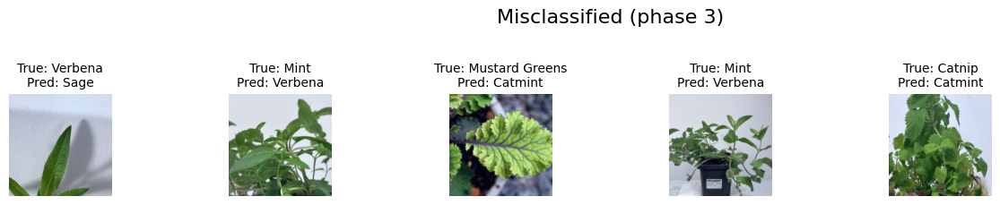

In [ ]:
plot_misclassified(misclassified_MNv2, "Misclassified (phase 3)", class_names)

## 2. Deploying the model (Model 1)

After training the MobileNetV2 model, the model parameters were saved in a PTH file called "best_model_MobileNetV2.pth". In combination with the code of section 2.1, the model is deployed based on the instructions from the following GitHub source: https://github.com/denistanjingyu/Image-Classification-Web-App-using-PyTorch-and-Streamlit

### 2.1 Code for the deployment (Model_1.py)

In [ ]:
# Model_1.py

# Import libraries
from PIL import Image
from torchvision import models, transforms
import torch
import torch.nn as nn
import streamlit as st

# Set up MobileNetV2
def setup_MobileNetV2(num_classes=20):
    # Load the pretrained MobileNetV2 model
    model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)

    # Replace the last classifier layer
    model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

    # Freezing all the parameters first
    for param in model.parameters():
        param.requires_grad = False

    # Unfreezing the parameters of the last three blocks
    for layer in [model.features[16], model.features[17], model.classifier]:
        for param in layer.parameters():
            param.requires_grad = True

    return model

# Set title of app
st.title("Simple Image Classification Application")
st.write("")

# Enable users to upload images for the model to make predictions
file_up = st.file_uploader("Upload an image", type="jpg")

def predict(image):
    """Return top 5 predictions ranked by highest probability.

    Parameters
    ----------
    :param image: uploaded image
    :type image: jpg
    :rtype: list
    :return: top 5 predictions ranked by highest probability
    """

    # Create a MobileNetV2 model
    model = setup_MobileNetV2()

    # Load the model weights
    model.load_state_dict(torch.load('best_model_MobileNetV2.pth'))
    model.eval()

    # Transform the input image through resizing, normalization
    transform = transforms.Compose([
        transforms.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
        transforms.CenterCrop(224),   # Cropping the center 224x224 pixels
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])

    # Load the image, pre-process it, and make predictions
    img = Image.open(image)
    batch_t = torch.unsqueeze(transform(img), 0)

    out = model(batch_t)

    with open('imagenet_classes.txt') as f:
        classes = [line.strip() for line in f.readlines()]

    # Return the top 5 predictions ranked by highest probabilities
    prob = torch.nn.functional.softmax(out, dim=1)[0] * 100
    _, indices = torch.sort(out, descending=True)
    return [(classes[idx], prob[idx].item()) for idx in indices[0][:5]]

if file_up is not None:
    # Display image that user uploaded
    image = Image.open(file_up)
    st.image(image, caption='Uploaded Image.', use_column_width=True)
    st.write("")
    st.write("Just a second ...")
    labels = predict(file_up)

    # Print out the top 5 prediction labels with scores
    for i in labels:
        st.write("Prediction (index, name)", i[0], ",   Score: ", i[1])


#### Website user interface:

![image.png](attachment:0997011f-34c9-4973-aab6-42c480390133.png)

### 2.2 Testing one image per class on the deployment website

#### Overview of all images:

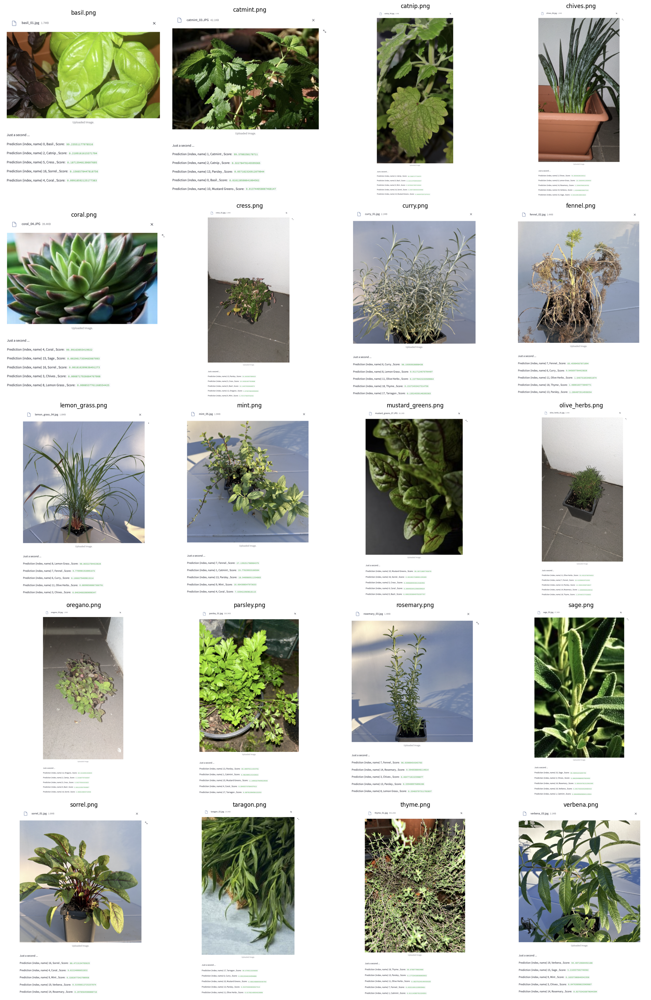

In [ ]:
# Listing all PNG files in the folder
image_files = [f for f in os.listdir(ui_model_1_path) if f.endswith('.png')]

# Creating a 5x4 subplot with larger figures
fig, axes = plt.subplots(5, 4, figsize=(20, 30))

# Interating through the images and plot them
for i, ax in enumerate(axes.flatten()):
    if i < len(image_files):
        img_path = os.path.join(ui_model_1_path, image_files[i])
        img = mpimg.imread(img_path)
        ax.imshow(img)
        ax.set_title(image_files[i], fontsize=12)  # Set filename as title
        ax.axis('off')  # Hide the axis

plt.tight_layout()
plt.show()

#### Looking at one image in detail:

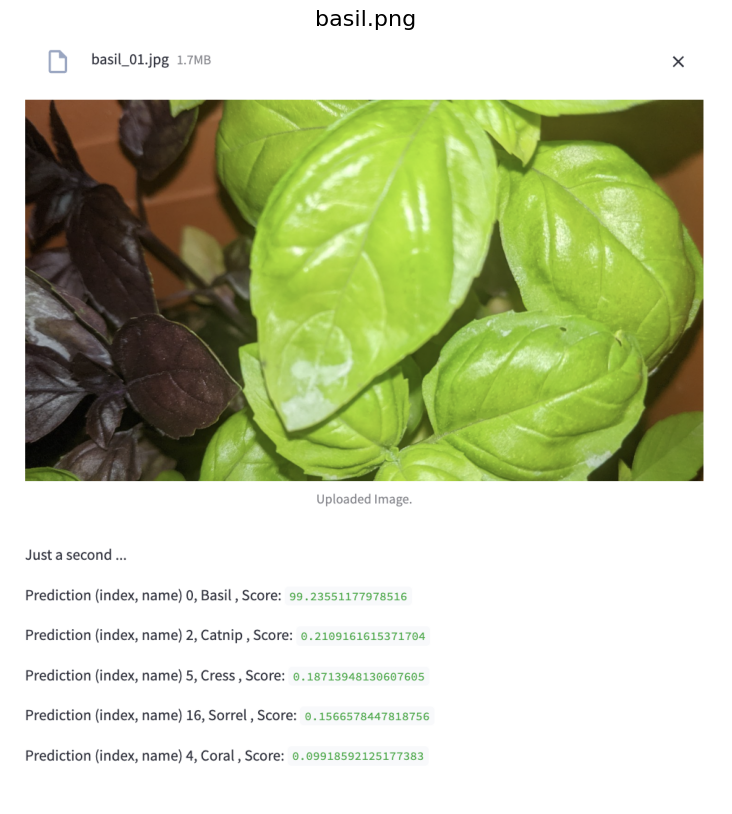

In [ ]:
# Listing all PNG files in the folder and selecting one to display
image_files = [f for f in os.listdir(ui_model_1_path) if f.endswith('.png')]
image_file = image_files[0]

# Load and display the image
fig, ax = plt.subplots(figsize=(10, 10))
img_path = os.path.join(ui_model_1_path, image_file)
img = mpimg.imread(img_path)
ax.imshow(img)
ax.set_title(image_file, fontsize=16)
ax.axis('off')
plt.show()

## 3. Testing the model on a new test dataset

In [ ]:
# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Defining a new function to load the model and test the new dataset
def evaluate_new_test(model, test_loader, device='cuda'):
    # Creating a MobileNetV2 model
    model = setup_MobileNetV2()

    # Loading the model weights
    model.load_state_dict(torch.load('best_model_MobileNetV2.pth'))
    model.to(device)
    model.eval()

    # Defining the criterion
    criterion = nn.CrossEntropyLoss()

    # Conducting the test
    total_loss = 0.0
    correct = 0
    total = 0
    misclassified = []  # Storing misclassified images and labels

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            total_loss += loss.item() * labels.size(0)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            # Collecting misclassified images and labels
            mask = predicted != labels
            misclassified_images = images[mask]
            misclassified_labels = labels[mask]
            misclassified_preds = predicted[mask]
            misclassified.extend(zip(misclassified_images.cpu(), misclassified_labels.cpu(), misclassified_preds.cpu()))

    accuracy = 100 * correct / total
    eval_loss = total_loss / total
    print(f'Final Evaluation on Test Set: Accuracy = {accuracy:.1f}%, Loss = {eval_loss:.4f}')
    print("Total:", total)
    print("Correct:", correct)
    miss=len(misclassified)
    print("Misclassified:", miss)
    return accuracy, eval_loss, misclassified

In [ ]:
# Preparing the MobileNetv2 model:
model_MNv2 = setup_MobileNetV2()

# Running evaluation of the new test dataset
accuracy_MNv2, eval_loss_MNv2, misclassified_test_v2 = evaluate_new_test(model_MNv2, dataloader_test_v2)

Final Evaluation on Test Set: Accuracy = 80.2%, Loss = 1.4497
Total: 197
Correct: 158
Misclassified: 39


In [ ]:
# Saving evaluation metrics to a JSON file
save_model_metrics(json_file_path, 'Phase 4 (first test)', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4 (first test) saved to 'accuracy.json'


In [ ]:
# Visualization of the JSON file for the evaluation metrics
table_df = json_to_table(json_file_path)
table_df_sorted = table_df.sort_index()

# Visualizing the table
table_str = tabulate(table_df_sorted, headers='keys', tablefmt='mixed_grid')
print(table_str)

┍━━━━━━━━━━━━━━━━━━━━━━┯━━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━┑
│                      │ accuracy   │   evaluation loss │
┝━━━━━━━━━━━━━━━━━━━━━━┿━━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━┥
│ Phase 3              │ 98.74%     │            0.0518 │
├──────────────────────┼────────────┼───────────────────┤
│ Phase 4 (first test) │ 80.20%     │            1.4497 │
┕━━━━━━━━━━━━━━━━━━━━━━┷━━━━━━━━━━━━┷━━━━━━━━━━━━━━━━━━━┙


The accuracy of the model dropped significantly from 98.7% to 80.2% for the new test dataset with more challenging conditions.

In [ ]:
# Defining the path to the JSON file
json_file_path_error_v2 = 'error_counts_v2.json'

# Preparing the error information in a dictionary
errors_MNv2 = count_errors(misclassified_test_v2)
new_error_counts = {
    'MobileNetv2_new_test': errors_MNv2
}

# Reading the existing data and updating it
try:
    # Attempt to open and read the file
    with open(json_file_path_error_v2, 'r') as file:
        data = json.load(file)
    data.update(new_error_counts)
except FileNotFoundError:
    # If the file does not exist, create new data
    data = new_error_counts

# Writing the updated data back to the JSON file
with open(json_file_path_error_v2, 'w') as file:
    json.dump(data, file)

print("Error information updated and saved to 'error_counts_v2.json'")

Error information updated and saved to 'error_counts_v2.json'


In [ ]:
# Defining the path the JSON file and the models to print
models_to_print = ['MobileNetv2_new_test']

# Loading and preparing the table
table_df = json_to_table_v2(json_file_path_error_v2, models_to_print)
numeric_cols = table_df.select_dtypes(include=[float]).columns
table_df[numeric_cols] = table_df[numeric_cols].fillna(-999)
table_df[numeric_cols] = table_df[numeric_cols].astype(int)
table_df.replace(-999, "-", inplace=True)
table_df.sort_index(inplace=True)

# Visualizing the table
headline = "\033[1mError counts for misclassified images:\033[0m"
table_str = tabulate(table_df, headers='keys', tablefmt='mixed_grid')
table = f"{headline}\n{table_str}"
print(table)

Error counts for misclassified images:
┍━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━━━━━━┑
│                                     │   MobileNetv2_new_test │
┝━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━━━━━━┥
│ True: Catnip, Pred: Catmint         │                     14 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Catnip, Pred: Mustard Greens  │                      1 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Chives, Pred: Rosemary        │                      1 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Cress, Pred: Basil            │                      2 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Fennel, Pred: Thyme           │                      1 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Mint, Pred: Cress             │                      2 │
├─────────────────────────────────────┼────────────

Instead of 5 misclassified images for the old test dataset, the model now misclassifies 39 images. Especially the "Catnip" class" is very difficult to classify for the model as it can be mixed up with the "Catmint" class".

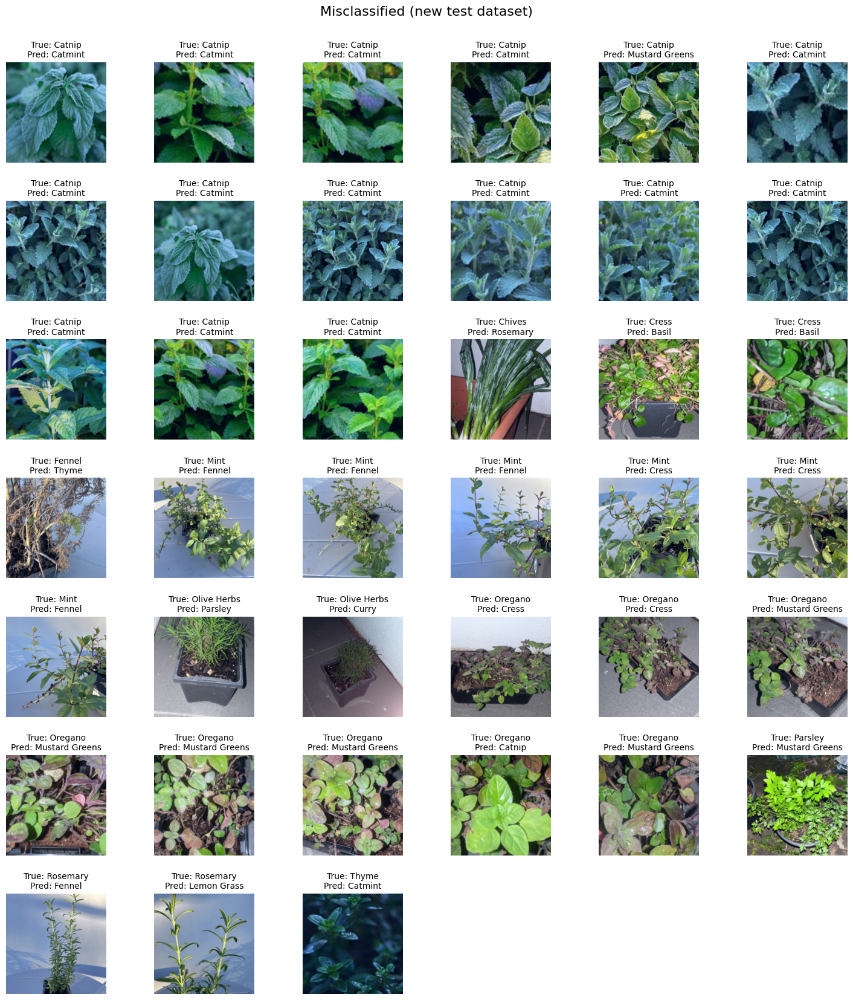

In [ ]:
plot_misclassified(misclassified_test_v2, "Misclassified (new test dataset)", class_names)

## 4. Using data augmentation to evaluate model improvement on the new test dataset

Data augmentation is a technique used in image classification where variations of training images are created by applying transformations such as rotation, scaling, flipping, and cropping. These augmented images help improve model generalization and robustness by exposing it to a wider range of variations during training. The following variants of data augmentation are tested individually:
- RandomHorizontalFlip
- RandomRotation
- ColorJitter
- RandomResizedCrop
- RandomErasing
- AutoAugment
- Combination of the best augmentation techniques.

Afterwards, the results are compared and a final decision about applying data augmentation concludes this section.

**According to the instructions, for all augmentations the training and validation will be done on the extended dataset (combination of three single datasets) but the testing will be based on the new test dataset with different conditions (dataloader_test_v2).**

In [ ]:
# Preparing the MobileNetv2 model:
model_MNv2 = setup_MobileNetV2()
optimizer_MNv2 = torch.optim.SGD(filter(lambda p: p.requires_grad, model_MNv2.parameters()), lr=0.01, momentum=0.9)
scheduler_MNv2 = torch.optim.lr_scheduler.StepLR(optimizer_MNv2, step_size=8, gamma=0.9)

### 4.1 Using RandomHorizontalFlip

RandomHorizontalFlip might help the models learn to recognize herbs regardless of their horizontal orientation, mimicking natural variances and potentially improving accuracy when dealing with new, unseen images.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.RandomHorizontalFlip(p=0.5),   # New Augmentation: Horizontally flip the input with probability of 0.5
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a1.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 10
Final Evaluation on Test Set: Accuracy = 78.7%, Loss = 1.4188


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug1=RandomHorizontalFlip', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug1=RandomHorizontalFlip saved to 'accuracy.json'


### 4.2 Using RandomRotation

RandomRotation might be an effective method because it helps the model generalize better by learning to recognize the herbs from various angles

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.RandomRotation(10),   # New Augmentation: Rotate the input by 10 degrees
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a2.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 7
Final Evaluation on Test Set: Accuracy = 77.7%, Loss = 1.5798


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug2=RandomRotation', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug2=RandomRotation saved to 'accuracy.json'


### 4.3 Using ColorJitter

ColorJitter migth be a good data augmentation technique because it varies the brightness, contrast, saturation, and hue of images. This helps the models learn to recognize the herbs under different lighting conditions and color variations.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),   # New Augmentation: Change the brightness, contrast, saturation and hue
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a3.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 5
Final Evaluation on Test Set: Accuracy = 77.7%, Loss = 1.5248


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug3=ColorJitter', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug3=ColorJitter saved to 'accuracy.json'


### 4.4 Using RandomResizedCrop

RandomResizedCrop might be an effective technique because it randomly crops different parts of the image and rescales them to a certain size, helping the model to focus on various aspects and features of the herbs, such as shape and texture of leaves.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.RandomResizedCrop(256, scale=(0.8, 1.0), ratio=(0.9, 1.1)),   # New Augmentation: Crop a random portion of the input and resize it to a given size.
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a4.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 7
Final Evaluation on Test Set: Accuracy = 75.1%, Loss = 1.5599


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug4=RandomResizedCrop', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug4=RandomResizedCrop saved to 'accuracy.json'


### 4.5 Using RandomErasing

RandomErasing might be beneficial because it introduces variability by randomly occluding parts of the images, which helps the models learn to recognize herbs based on incomplete visual information.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.RandomErasing(p=0.1, scale=(0.02, 0.33), ratio=(0.3, 3.3), value=0),   # New Augmentation: Randomly selects a rectangle region in an image and erases its pixels.
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a5.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 4
Final Evaluation on Test Set: Accuracy = 78.2%, Loss = 1.5071


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug5=RandomErasing', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug5=RandomErasing saved to 'accuracy.json'


### 4.6 Using AutoAugment

AutoAugment migth be particularly helpful as it automatically searches for the best augmentation policies, adapting to the specific features of the culinary herb images like shape, size, and texture.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.AutoAugment(transforms.AutoAugmentPolicy.IMAGENET),   # New Augmentation: AutoAugment data augmentation
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a6.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 4
Final Evaluation on Test Set: Accuracy = 63.5%, Loss = 2.1015


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug6=AutoAugment', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug6=AutoAugment saved to 'accuracy.json'


### 4.7 Using a combination of the two best augmentation techniques

In [ ]:
# Re-visualize the JSON file for the evaluation metrics
table_df = json_to_table(json_file_path)
table_df_sorted = table_df.sort_index()

# Visualizing the table again
table_str = tabulate(table_df_sorted, headers='keys', tablefmt='pipe')
print(table_str)

|                                    | accuracy   |   evaluation loss |
|:-----------------------------------|:-----------|------------------:|
| Phase 3                            | 98.74%     |            0.0518 |
| Phase 4 (first test)               | 80.20%     |            1.4497 |
| Phase 4: aug1=RandomHorizontalFlip | 78.68%     |            1.4188 |
| Phase 4: aug2=RandomRotation       | 77.66%     |            1.5798 |
| Phase 4: aug3=ColorJitter          | 77.66%     |            1.5248 |
| Phase 4: aug4=RandomResizedCrop    | 75.13%     |            1.5599 |
| Phase 4: aug5=RandomErasing        | 78.17%     |            1.5071 |
| Phase 4: aug6=AutoAugment          | 63.45%     |            2.1015 |


Based on the tests for single augmentation techniques, RandomHorizontalFlip had the highest accuracy of the different techniques (78.68%) and RandomErasing the second highest accuracy (78.17%). Now, these two augmentation techniques are tested together in one transformation

In [ ]:
# Defining a transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.RandomHorizontalFlip(p=0.5),   # New Augmentation: Horizontally flip the input with probability of 0.5
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.RandomErasing(p=0.1, scale=(0.02, 0.33), ratio=(0.3, 3.3), value=0),   # New Augmentation: Randomly selects a rectangle region in an image and erases its pixels.
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a7.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 5
Final Evaluation on Test Set: Accuracy = 80.2%, Loss = 1.5741


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug7=combination_1', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug7=combination_1 saved to 'accuracy.json'


### 4.8 Using a combination of the two best augmentation techniques with different hyperparameters

The combination of the two best augmentation techniques performed better than the previous tested techniques. Nevertheless, the accuracy is just on level with the model without augmentation, without an improvement. Therefore, the hyperparameter will be fine-tuned to try to get a slightly better result.

In [ ]:
# Defining a transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.RandomHorizontalFlip(p=0.5),   # New Augmentation: Horizontally flip the input with probability of 0.5
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.RandomErasing(p=0.05, scale=(0.01, 0.1), ratio=(0.5, 2.0), value=0),   # New hyperparameter for a decreased probability and smaller erasing area
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a9.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 7
Final Evaluation on Test Set: Accuracy = 79.2%, Loss = 1.6891


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug8=combination_1_fine-tuned', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug8=combination_1_fine-tuned saved to 'accuracy.json'


### 4.9 Fine-tuning the ColorJitter augmentation

The fine-tuned augmentation (RandomHorizontalFlip + RandomErasing) was not able to surpass the model without augmentation. Therefore, another approach will be started. The ColorJitter augmentation with default parameters was not the best augmentation. But changing the brightness and contrast seem to be a good possibility to improve data quality and consequesntly accuracy.

In [ ]:
# Defining a new transformation with augmentation
transform_224 = transforms.v2.Compose([
    transforms.v2.ColorJitter(brightness=0.3, contrast=0.4),   # Fine-tunes parameters
    transforms.v2.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
    transforms.v2.CenterCrop(224),   # Cropping the center 224x224 pixels
    transforms.v2.ToImage(),
    transforms.v2.ToDtype(torch.float32, scale=True),
    transforms.v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loading the new test dataset
dataset_test_v2 = datasets.ImageFolder(root=dataset_path_test, transform=transform_224)
print(f"Length of new dataset for different conditions: {len(dataset_test_v2)}")

# Creating the DataLoader
dataloader_test_v2 = DataLoader(dataset_test_v2, batch_size=32, shuffle=False)

Length of new dataset for different conditions: 197


In [ ]:
# Running the training and evaluation
accuracy_MNv2, eval_loss_MNv2, misclassified_MNv2 = train_and_evaluate_v3(model_MNv2, dataloader_224_train, dataloader_224_val, dataloader_test_v2, optimizer_MNv2, scheduler_MNv2, 'best_model_MobileNetV2_a10.pth', early_stopping_patience=3, class_names=class_names)

Early stopping triggered at epoch 6
Final Evaluation on Test Set: Accuracy = 81.2%, Loss = 1.5108


In [ ]:
save_model_metrics(json_file_path, 'Phase 4: aug9=ColorJitter_fine-tuned', accuracy_MNv2, eval_loss_MNv2)

Model metrics for Phase 4: aug9=ColorJitter_fine-tuned saved to 'accuracy.json'


### 4.10 Data augmentation summary

In [ ]:
# Re-visualize the JSON file for the evaluation metrics
table_df = json_to_table(json_file_path)
table_df_sorted = table_df.sort_index()

# Visualizing the table again
table_str = tabulate(table_df_sorted, headers='keys', tablefmt='pipe')
print(table_str)

|                                        | accuracy   |   evaluation loss |
|:---------------------------------------|:-----------|------------------:|
| Phase 3                                | 98.74%     |            0.0518 |
| Phase 4 (first test)                   | 80.20%     |            1.4497 |
| Phase 4: aug1=RandomHorizontalFlip     | 78.68%     |            1.4188 |
| Phase 4: aug2=RandomRotation           | 77.66%     |            1.5798 |
| Phase 4: aug3=ColorJitter              | 77.66%     |            1.5248 |
| Phase 4: aug4=RandomResizedCrop        | 75.13%     |            1.5599 |
| Phase 4: aug5=RandomErasing            | 78.17%     |            1.5071 |
| Phase 4: aug6=AutoAugment              | 63.45%     |            2.1015 |
| Phase 4: aug7=combination_1            | 80.20%     |            1.5741 |
| Phase 4: aug8=combination_1_fine-tuned | 79.19%     |            1.6891 |
| Phase 4: aug9=ColorJitter_fine-tuned   | 81.22%     |            1.4041 |


Several augmentation methods were tested. The first impression is that it was very hard to reach the same accuracy as the model (transformation) without augmentation. In addition, the best augmentation technique was only able to be 1% better than the model (transformation) without augmentation. One assumption can be that the model was not able to learn enough features in detail due to the small dataset and in our case the lack of multiple plants per class. Therefore, the augmentation itself is not able to compensate this issue.

### 4.11 Final evaluation of fine-tuned model and analysis of misclassified images

In [ ]:
# Create a MobileNetV2 model
model = setup_MobileNetV2()

# Load the model weights
model.load_state_dict(torch.load('best_model_MobileNetV2_a10.pth'))
model.eval()

# Running evaluation of the new test dataset
accuracy_MNv2, eval_loss_MNv2, misclassified_test_v2 = evaluate_new_test(model_MNv2, dataloader_test_v2)

Final Evaluation on Test Set: Accuracy = 81.2%, Loss = 1.4041
Total: 197
Correct: 160
Misclassified: 37


In [ ]:
# Defining the path to the JSON file
json_file_path_error_v3 = 'error_counts_v3.json'

# Preparing the error information in a dictionary
errors_MNv2 = count_errors(misclassified_test_v2)
new_error_counts = {
    'MobileNetv2_new_test': errors_MNv2
}

# Reading the existing data and updating it
try:
    # Attempt to open and read the file
    with open(json_file_path_error_v3, 'r') as file:
        data = json.load(file)
    data.update(new_error_counts)
except FileNotFoundError:
    # If the file does not exist, create new data
    data = new_error_counts

# Writing the updated data back to the JSON file
with open(json_file_path_error_v3, 'w') as file:
    json.dump(data, file)

print("Error information updated and saved to 'error_counts_v3.json'")

Error information updated and saved to 'error_counts_v3.json'


In [ ]:
# Defining the path the JSON file and the models to print
models_to_print = ['MobileNetv2_new_test']

# Loading and preparing the table
table_df = json_to_table_v2(json_file_path_error_v3, models_to_print)
numeric_cols = table_df.select_dtypes(include=[float]).columns
table_df[numeric_cols] = table_df[numeric_cols].fillna(-999)
table_df[numeric_cols] = table_df[numeric_cols].astype(int)
table_df.replace(-999, "-", inplace=True)
table_df.sort_index(inplace=True)

# Visualizing the table
headline = "\033[1mError counts for misclassified images:\033[0m"
table_str = tabulate(table_df, headers='keys', tablefmt='mixed_grid')
table = f"{headline}\n{table_str}"
print(table)

Error counts for misclassified images:
┍━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━━━━━━┑
│                                     │   MobileNetv2_new_test │
┝━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━━━━━━┥
│ True: Catnip, Pred: Catmint         │                     15 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Chives, Pred: Lemon Grass     │                      2 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Cress, Pred: Basil            │                      1 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Cress, Pred: Parsley          │                      1 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Mint, Pred: Catmint           │                      3 │
├─────────────────────────────────────┼────────────────────────┤
│ True: Mint, Pred: Cress             │                      1 │
├─────────────────────────────────────┼────────────

Due to the slight increase in accuracy, the total number of misclassified images went down from 39 to 37 for the fine-tunes model. The general impression of the misclassified images distribution remains the same. Several classes are misclassified and the "Catnip" class is also very hard for the fine-tunes model to allocate.

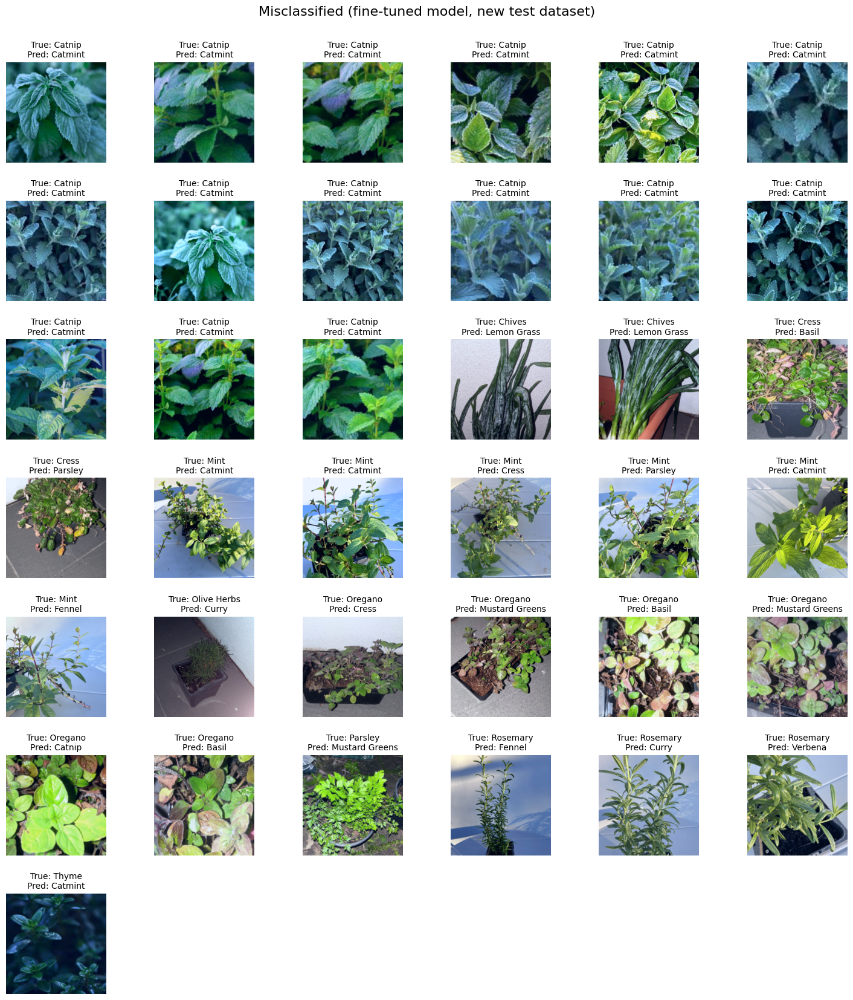

In [ ]:
plot_misclassified(misclassified_test_v2, "Misclassified (fine-tuned model, new test dataset)", class_names)

## 5. Deploying the fine-tuned model (Model 2)

The procesdure for deployment remains the same to section 2 with model 1. Just the saved model parameters of the saved PTH file is different due to the updated fine-tuned model.

### 5.1 Code for the deployment (Model_1.py)

In [ ]:
# Model_1.py

# Import libraries
from PIL import Image
from torchvision import models, transforms
import torch
import torch.nn as nn
import streamlit as st

# Set up MobileNetV2
def setup_MobileNetV2(num_classes=20):
    # Load the pretrained MobileNetV2 model
    model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)

    # Replace the last classifier layer
    model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

    # Freezing all the parameters first
    for param in model.parameters():
        param.requires_grad = False

    # Unfreezing the parameters of the last three blocks
    for layer in [model.features[16], model.features[17], model.classifier]:
        for param in layer.parameters():
            param.requires_grad = True

    return model

# Set title of app
st.title("Simple Image Classification Application")
st.write("")

# Enable users to upload images for the model to make predictions
file_up = st.file_uploader("Upload an image", type="jpg")

def predict(image):
    """Return top 5 predictions ranked by highest probability.

    Parameters
    ----------
    :param image: uploaded image
    :type image: jpg
    :rtype: list
    :return: top 5 predictions ranked by highest probability
    """

    # Create a MobileNetV2 model
    model = setup_MobileNetV2()

    # Load the model weights
    model.load_state_dict(torch.load('best_model_MobileNetV2_a10.pth'))
    model.eval()

    # Transform the input image through resizing, normalization
    transform = transforms.Compose([
        transforms.Resize(256),   # Resizing the smaller side of the image to 256 while maintaining aspect ratio
        transforms.CenterCrop(224),   # Cropping the center 224x224 pixels
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])

    # Load the image, pre-process it, and make predictions
    img = Image.open(image)
    batch_t = torch.unsqueeze(transform(img), 0)

    out = model(batch_t)

    with open('imagenet_classes.txt') as f:
        classes = [line.strip() for line in f.readlines()]

    # Return the top 5 predictions ranked by highest probabilities
    prob = torch.nn.functional.softmax(out, dim=1)[0] * 100
    _, indices = torch.sort(out, descending=True)
    return [(classes[idx], prob[idx].item()) for idx in indices[0][:5]]

if file_up is not None:
    # Display image that user uploaded
    image = Image.open(file_up)
    st.image(image, caption='Uploaded Image.', use_column_width=True)
    st.write("")
    st.write("Just a second ...")
    labels = predict(file_up)

    # Print out the top 5 prediction labels with scores
    for i in labels:
        st.write("Prediction (index, name)", i[0], ",   Score: ", i[1])


### 5.2 Testing four sample images

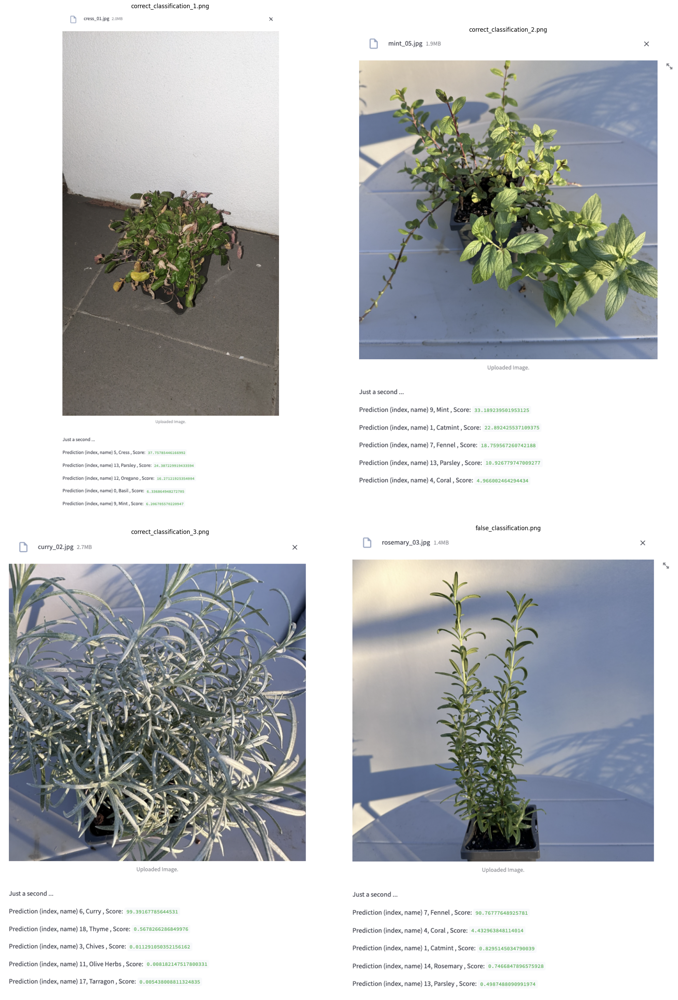

In [ ]:
# Listing all PNG files in the folder
image_files = [f for f in os.listdir(ui_model_2_path) if f.endswith('.png')]

# Creating a 5x4 subplot with larger figures
fig, axes = plt.subplots(2, 2, figsize=(20, 30))

# Interating through the images and plot them
for i, ax in enumerate(axes.flatten()):
    if i < len(image_files):
        img_path = os.path.join(ui_model_2_path, image_files[i])
        img = mpimg.imread(img_path)
        ax.imshow(img)
        ax.set_title(image_files[i], fontsize=12)  # Set filename as title
        ax.axis('off')  # Hide the axis

plt.tight_layout()
plt.show()

## 6. Evaluation of phase 4

### 6.1 Final comparison of both models

In [ ]:
json_file_path_error_v2 = 'error_counts_v2.json'
json_file_path_error_v3 = 'error_counts_v3.json'

models_to_print = ['MobileNetv2_new_test']

# Load and prepare the tables from both files
table_df_v2 = json_to_table_v2(json_file_path_error_v2, models_to_print)
table_df_v3 = json_to_table_v2(json_file_path_error_v3, models_to_print)

# Combine the data from both tables
combined_df = pd.concat([table_df_v2, table_df_v3], axis=1)
combined_df.columns = ['Model 1', 'Model 2 (fine-tuned)']

# Replace NaN values and convert columns to integer where necessary
numeric_cols = combined_df.select_dtypes(include=[float]).columns
combined_df[numeric_cols] = combined_df[numeric_cols].fillna(-999)
combined_df[numeric_cols] = combined_df[numeric_cols].astype(int)
combined_df.replace(-999, "-", inplace=True)
combined_df.sort_index(inplace=True)

# Visualize the combined table
headline = "\033[1mError counts for misclassified images from both models:\033[0m"
table_str = tabulate(combined_df, headers='keys', tablefmt='mixed_grid')
table = f"{headline}\n{table_str}"
print(table)

Error counts for misclassified images from both models:
┍━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┯━━━━━━━━━━━┯━━━━━━━━━━━━━━━━━━━━━━━━┑
│                                     │ Model 1   │ Model 2 (fine-tuned)   │
┝━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┿━━━━━━━━━━━┿━━━━━━━━━━━━━━━━━━━━━━━━┥
│ True: Catnip, Pred: Catmint         │ 14        │ 15                     │
├─────────────────────────────────────┼───────────┼────────────────────────┤
│ True: Catnip, Pred: Mustard Greens  │ 1         │ -                      │
├─────────────────────────────────────┼───────────┼────────────────────────┤
│ True: Chives, Pred: Lemon Grass     │ -         │ 2                      │
├─────────────────────────────────────┼───────────┼────────────────────────┤
│ True: Chives, Pred: Rosemary        │ 1         │ -                      │
├─────────────────────────────────────┼───────────┼────────────────────────┤
│ True: Cress, Pred: Basil            │ 2         │ 1                      │
├───────────────────

Overall, it was possible to fine-tune the model and increse the model's accuracy slightly. Nevertheless, since the accuracy of both models are very similar (Model 1: 80.2%, Model 2: 81.2%), the focus here is more on the misclassified images. The table above shows both misclassification distributions. While some misclassifications are quite similar in total count (+-1), there are 12 missclassification types, where one of the models did not make a misclassification error but the other did at least one. This can be interpreted to mean that the same images are sometimes classified correctly and sometimes incorrectly, depending on the model. Except for the “Catnip” class, the numbers are not very low, but they add up and thus prevent a better overall performance for both models.

### 6.2 Limitations of this assignment

In generel, the limitation of this assignment is the small dataset and the fact that each code is only run once. As a consequence, the accuracy can vary in a small range per run. As seen in the section 4 about augmentation techniques, where different techniques are very close in accuracy, this could lead to misinterpretations in comparison to several runs with an average accuracy of these runs.

### 6.3 Potential for improvement and areas of further investigation

The most obvious improvement, which is directly linked to the previously mentioned limitations, is to increase the number of images per class. This could be achieved by including multiple plants per class instead of one and to collect images of different conditions, like different weather or different backgrounds. Especially for classes with very similar leaves, this would be beneficial.

Another area to investigate could be high quality images of leaves. Capturing fine details of leaf patterns, texture and edges would enrich the model's feature learning. This would be especially effective, if leaves would be photographed with a neutral background so that the model could compleatly focus on the details and relevant parts of the leaves without distraction.